<a href="https://colab.research.google.com/github/fjoyshee/Cab-Investment-firm_-EDA-recommendation-and-hypothesis-results/blob/main/EDA_recommendation_results.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

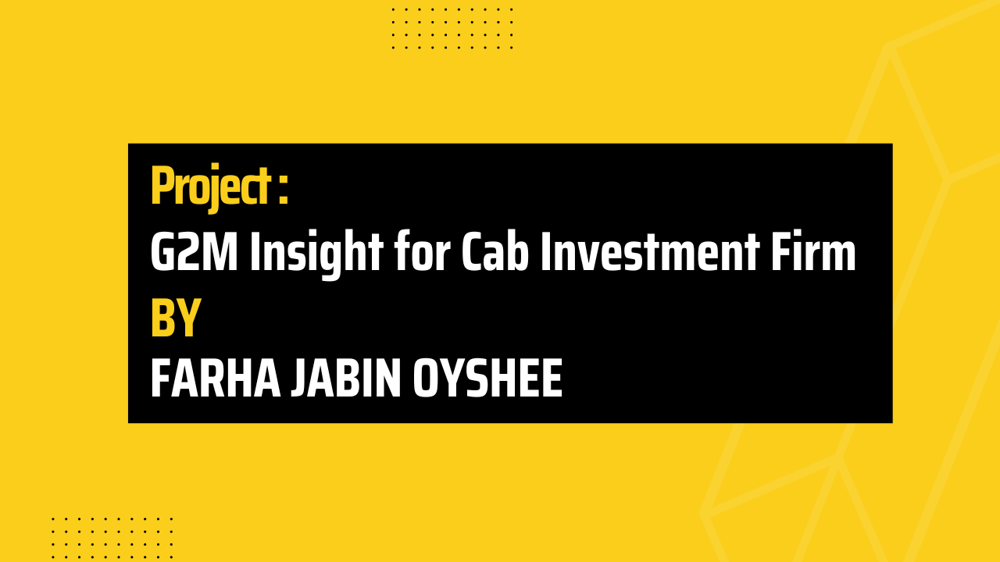

# **Import Libraries and Dataset**

In [ ]:
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats
import matplotlib.pyplot as plt
import matplotlib

import scipy.stats as stat
from scipy.stats import ttest_1samp
from scipy.stats import ttest_ind

sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (15, 9)
matplotlib.rcParams['figure.facecolor'] = '#00000000'
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

**Import Cab Data**

In [ ]:
from google.colab import files
files.upload()

Saving Cab_Data.csv to Cab_Data (1).csv


{'Cab_Data.csv': b'Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip\r\n10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635\r\n10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854\r\n10000013,42371,Pink Cab,ATLANTA GA,9.04,125.2,97.632\r\n10000014,42376,Pink Cab,ATLANTA GA,33.17,377.4,351.602\r\n10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776\r\n10000016,42376,Pink Cab,ATLANTA GA,6.06,72.43,63.024\r\n10000017,42372,Pink Cab,AUSTIN TX,44,576.15,475.2\r\n10000018,42376,Pink Cab,AUSTIN TX,35.65,466.1,377.89\r\n10000019,42381,Pink Cab,BOSTON MA,14.4,191.61,146.88\r\n10000020,42375,Pink Cab,BOSTON MA,10.89,156.98,113.256\r\n10000021,42380,Pink Cab,BOSTON MA,39.6,570.83,475.2\r\n10000022,42375,Pink Cab,BOSTON MA,21.8,317.27,220.18\r\n10000023,42380,Pink Cab,BOSTON MA,12,158.01,134.4\r\n10000024,42375,Pink Cab,BOSTON MA,32.67,470.94,392.04\r\n10000025,42377,Pink Cab,BOSTON MA,25.52,360.79,298.584\r\n10000026,42379,Pink Cab,BOSTON MA,15.54,234.78,1

In [ ]:
cab_df = pd.read_csv('Cab_Data.csv')
cab_df.head(10)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip
0,10000011,42377,Pink Cab,ATLANTA GA,30.45,370.95,313.635
1,10000012,42375,Pink Cab,ATLANTA GA,28.62,358.52,334.854
2,10000013,42371,Pink Cab,ATLANTA GA,9.04,125.20,97.632
3,10000014,42376,Pink Cab,ATLANTA GA,33.17,377.40,351.602
4,10000015,42372,Pink Cab,ATLANTA GA,8.73,114.62,97.776
5,10000016,42376,Pink Cab,ATLANTA GA,6.06,72.43,63.024
6,10000017,42372,Pink Cab,AUSTIN TX,44.00,576.15,475.200
7,10000018,42376,Pink Cab,AUSTIN TX,35.65,466.10,377.890
8,10000019,42381,Pink Cab,BOSTON MA,14.40,191.61,146.880
9,10000020,42375,Pink Cab,BOSTON MA,10.89,156.98,113.256


In [ ]:
#Data Info
cab_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 359392 entries, 0 to 359391
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Transaction ID  359392 non-null  int64  
 1   Date of Travel  359392 non-null  int64  
 2   Company         359392 non-null  object 
 3   City            359392 non-null  object 
 4   KM Travelled    359392 non-null  float64
 5   Price Charged   359392 non-null  float64
 6   Cost of Trip    359392 non-null  float64
dtypes: float64(3), int64(2), object(2)
memory usage: 19.2+ MB


In [ ]:
#Data Type
cab_df.dtypes

Transaction ID      int64
Date of Travel      int64
Company            object
City               object
KM Travelled      float64
Price Charged     float64
Cost of Trip      float64
dtype: object

In [ ]:
#Datatype ofDate of Travel datatype --> DateTime 
a = cab_df['Date of Travel'].to_list()
base_date = pd.Timestamp('1899-12-29')
dates = [base_date + pd.DateOffset(date_offset) for date_offset in a]
cab_df['Date of Travel'] = pd.to_datetime(dates, format='%y/%m/%d')


In [ ]:
#Data Description
cab_df.describe

<bound method NDFrame.describe of         Transaction ID Date of Travel     Company           City  \
0             10000011     2016-01-07    Pink Cab     ATLANTA GA   
1             10000012     2016-01-05    Pink Cab     ATLANTA GA   
2             10000013     2016-01-01    Pink Cab     ATLANTA GA   
3             10000014     2016-01-06    Pink Cab     ATLANTA GA   
4             10000015     2016-01-02    Pink Cab     ATLANTA GA   
...                ...            ...         ...            ...   
359387        10440101     2018-01-07  Yellow Cab  WASHINGTON DC   
359388        10440104     2018-01-03  Yellow Cab  WASHINGTON DC   
359389        10440105     2018-01-04  Yellow Cab  WASHINGTON DC   
359390        10440106     2018-01-04  Yellow Cab  WASHINGTON DC   
359391        10440107     2018-01-01  Yellow Cab  WASHINGTON DC   

        KM Travelled  Price Charged  Cost of Trip  
0              30.45         370.95      313.6350  
1              28.62         358.52      334.

In [ ]:
#Column of Company
cab_df['Company'].unique()

array(['Pink Cab', 'Yellow Cab'], dtype=object)

In [ ]:
#Column of City
cab_df['City'].unique()


array(['ATLANTA GA', 'AUSTIN TX', 'BOSTON MA', 'CHICAGO IL', 'DALLAS TX',
       'DENVER CO', 'LOS ANGELES CA', 'MIAMI FL', 'NASHVILLE TN',
       'NEW YORK NY', 'ORANGE COUNTY', 'PHOENIX AZ', 'PITTSBURGH PA',
       'SACRAMENTO CA', 'SAN DIEGO CA', 'SEATTLE WA', 'SILICON VALLEY',
       'TUCSON AZ', 'WASHINGTON DC'], dtype=object)

**Import City Data**

In [ ]:
from google.colab import files
files.upload()

Saving City.csv to City.csv


{'City.csv': b'City,Population,Users\r\nNEW YORK NY," 8,405,837 "," 302,149 "\r\nCHICAGO IL," 1,955,130 "," 164,468 "\r\nLOS ANGELES CA," 1,595,037 "," 144,132 "\r\nMIAMI FL," 1,339,155 "," 17,675 "\r\nSILICON VALLEY," 1,177,609 "," 27,247 "\r\nORANGE COUNTY," 1,030,185 "," 12,994 "\r\nSAN DIEGO CA," 959,307 "," 69,995 "\r\nPHOENIX AZ," 943,999 "," 6,133 "\r\nDALLAS TX," 942,908 "," 22,157 "\r\nATLANTA GA," 814,885 "," 24,701 "\r\nDENVER CO," 754,233 "," 12,421 "\r\nAUSTIN TX," 698,371 "," 14,978 "\r\nSEATTLE WA," 671,238 "," 25,063 "\r\nTUCSON AZ," 631,442 "," 5,712 "\r\nSAN FRANCISCO CA," 629,591 "," 213,609 "\r\nSACRAMENTO CA," 545,776 "," 7,044 "\r\nPITTSBURGH PA," 542,085 "," 3,643 "\r\nWASHINGTON DC," 418,859 "," 127,001 "\r\nNASHVILLE TN," 327,225 "," 9,270 "\r\nBOSTON MA," 248,968 "," 80,021 "\r\n'}

In [ ]:
city_df = pd.read_csv('City.csv')
city_df.head(5)

,City,Population,Users
0,NEW YORK NY,"8,405,837","302,149"
1,CHICAGO IL,"1,955,130","164,468"
2,LOS ANGELES CA,"1,595,037","144,132"
3,MIAMI FL,"1,339,155","17,675"
4,SILICON VALLEY,"1,177,609","27,247"


In [ ]:
#Data Info
city_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   City        20 non-null     object
 1   Population  20 non-null     object
 2   Users       20 non-null     object
dtypes: object(3)
memory usage: 608.0+ bytes


In [ ]:
# 'Population' --> integer
city_df['Population'] = [x.replace(',','') for x in city_df['Population']]
city_df['Population'] = city_df['Population'].astype(float)

#  'Users' --> integer
city_df['Users'] = [x.replace(',','') for x in city_df['Users']]
city_df['Users'] = city_df['Users'].astype(float)

In [ ]:
#data types
city_df.dtypes



City           object
Population    float64
Users         float64
dtype: object

In [ ]:
#Description
city_df.describe()


,Population,Users
count,2.000000e+01,20.000000
mean,1.231592e+06,64520.650000
std,1.740127e+06,83499.375289
min,2.489680e+05,3643.000000
25%,6.086372e+05,11633.250000
50%,7.845590e+05,23429.000000
75%,1.067041e+06,91766.000000
max,8.405837e+06,302149.000000


**Import Transaction ID Data**

In [ ]:
from google.colab import files
files.upload()

Saving Transaction_ID.csv to Transaction_ID.csv


{'Transaction_ID.csv': b'Transaction ID,Customer ID,Payment_Mode\r\n10000011,29290,Card\r\n10000012,27703,Card\r\n10000013,28712,Cash\r\n10000014,28020,Cash\r\n10000015,27182,Card\r\n10000016,27318,Cash\r\n10000017,33788,Card\r\n10000018,34106,Card\r\n10000019,59799,Cash\r\n10000020,57982,Cash\r\n10000021,58774,Cash\r\n10000022,58627,Card\r\n10000023,59007,Card\r\n10000024,58215,Cash\r\n10000025,59372,Cash\r\n10000026,57950,Cash\r\n10000027,59533,Card\r\n10000028,58346,Cash\r\n10000029,58925,Card\r\n10000030,58551,Card\r\n10000031,59804,Card\r\n10000032,57200,Card\r\n10000033,57931,Cash\r\n10000034,3077,Cash\r\n10000035,4734,Card\r\n10000036,4004,Card\r\n10000037,5528,Card\r\n10000038,5785,Card\r\n10000039,3714,Cash\r\n10000040,3746,Card\r\n10000041,4289,Card\r\n10000042,5777,Cash\r\n10000043,3571,Card\r\n10000044,4779,Cash\r\n10000045,5734,Card\r\n10000046,5734,Cash\r\n10000047,3051,Card\r\n10000048,5915,Card\r\n10000049,5628,Cash\r\n10000050,3125,Cash\r\n10000051,4813,Cash\r\n1000005

In [ ]:
transaction_id_df = pd.read_csv('Transaction_ID.csv')
transaction_id_df.head()

,Transaction ID,Customer ID,Payment_Mode
0,10000011,29290,Card
1,10000012,27703,Card
2,10000013,28712,Cash
3,10000014,28020,Cash
4,10000015,27182,Card


In [ ]:
#Data Info
transaction_id_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 440098 entries, 0 to 440097
Data columns (total 3 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   Transaction ID  440098 non-null  int64 
 1   Customer ID     440098 non-null  int64 
 2   Payment_Mode    440098 non-null  object
dtypes: int64(2), object(1)
memory usage: 10.1+ MB


In [ ]:
#Data Description
transaction_id_df.describe(include = 'all', datetime_is_numeric=True)


,Transaction ID,Customer ID,Payment_Mode
count,4.400980e+05,440098.000000,440098
unique,NaN,NaN,2
top,NaN,NaN,Card
freq,NaN,NaN,263991
mean,1.022006e+07,23619.513120,NaN
std,1.270455e+05,21195.549816,NaN
min,1.000001e+07,1.000000,NaN
25%,1.011004e+07,3530.000000,NaN
50%,1.022006e+07,15168.000000,NaN
75%,1.033008e+07,43884.000000,NaN


**Import Customer ID Data**

In [ ]:
from google.colab import files
files.upload()

Saving Customer_ID.csv to Customer_ID.csv


{'Customer_ID.csv': b'Customer ID,Gender,Age,Income (USD/Month)\r\n29290,Male,28,10813\r\n27703,Male,27,9237\r\n28712,Male,53,11242\r\n28020,Male,23,23327\r\n27182,Male,33,8536\r\n27318,Male,25,13984\r\n33788,Male,23,23788\r\n34106,Male,19,19980\r\n59799,Male,33,19271\r\n57982,Male,57,5068\r\n58774,Male,20,23602\r\n58627,Male,28,27338\r\n59007,Male,63,6683\r\n58215,Male,25,6862\r\n59372,Male,53,4912\r\n57950,Male,58,16997\r\n59533,Male,29,17520\r\n58346,Male,27,21650\r\n58925,Male,38,26550\r\n58551,Male,25,21734\r\n59804,Male,31,4550\r\n57200,Male,23,3268\r\n57931,Male,40,5666\r\n3077,Male,22,16759\r\n4734,Male,33,30608\r\n4004,Male,18,3896\r\n5528,Male,34,14974\r\n5785,Male,21,11230\r\n3714,Male,33,4521\r\n3746,Male,24,2371\r\n4289,Male,19,28719\r\n5777,Male,24,28850\r\n3571,Male,44,15166\r\n4779,Male,27,6416\r\n5734,Male,23,22475\r\n3051,Male,30,34757\r\n5915,Male,26,24115\r\n5628,Male,33,15231\r\n3125,Male,25,9562\r\n4813,Male,46,24809\r\n4682,Male,62,6075\r\n3787,Male,27,33382\r\n5

In [ ]:
customer_id_df = pd.read_csv('Customer_ID.csv')
customer_id_df.head()

,Customer ID,Gender,Age,Income (USD/Month)
0,29290,Male,28,10813
1,27703,Male,27,9237
2,28712,Male,53,11242
3,28020,Male,23,23327
4,27182,Male,33,8536


In [ ]:
#Data Info
customer_id_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49171 entries, 0 to 49170
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Customer ID         49171 non-null  int64 
 1   Gender              49171 non-null  object
 2   Age                 49171 non-null  int64 
 3   Income (USD/Month)  49171 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 1.5+ MB


In [ ]:
#Data Description 
customer_id_df.describe( include = 'all')

,Customer ID,Gender,Age,Income (USD/Month)
count,49171.000000,49171,49171.000000,49171.000000
unique,NaN,2,NaN,NaN
top,NaN,Male,NaN,NaN
freq,NaN,26562,NaN,NaN
mean,28398.252283,NaN,35.363121,15015.631856
std,17714.137333,NaN,12.599066,8002.208253
min,1.000000,NaN,18.000000,2000.000000
25%,12654.500000,NaN,25.000000,8289.500000
50%,27631.000000,NaN,33.000000,14656.000000
75%,43284.500000,NaN,42.000000,21035.000000


#**Data Exploration and Visualize the Whole Dataset**

In [ ]:
df= cab_df.merge(transaction_id_df, on= 'Transaction ID').merge(customer_id_df, on ='Customer ID').merge(city_df, on = 'City')
df.head(5)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Gender,Age,Income (USD/Month),Population,Users
0,10000011,2016-01-07,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,29290,Card,Male,28,10813,814885.0,24701.0
1,10351127,2018-07-20,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,29290,Cash,Male,28,10813,814885.0,24701.0
2,10412921,2018-11-22,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,29290,Card,Male,28,10813,814885.0,24701.0
3,10000012,2016-01-05,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,27703,Card,Male,27,9237,814885.0,24701.0
4,10320494,2018-04-20,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,27703,Card,Male,27,9237,814885.0,24701.0


**Correlation Check**

In [ ]:
data_corr = df.corr()
data_corr

,Transaction ID,KM Travelled,Price Charged,Cost of Trip,Customer ID,Age,Income (USD/Month),Population,Users
Transaction ID,1.000000,-0.001429,-0.052902,-0.003462,-0.016912,-0.001267,-0.001570,0.023868,0.013526
KM Travelled,-0.001429,1.000000,0.835753,0.981848,0.000389,-0.000369,-0.000544,-0.002311,-0.000428
Price Charged,-0.052902,0.835753,1.000000,0.859812,-0.177324,-0.003084,0.003228,0.326589,0.281061
Cost of Trip,-0.003462,0.981848,0.859812,1.000000,0.003077,-0.000189,-0.000633,0.015108,0.023628
Customer ID,-0.016912,0.000389,-0.177324,0.003077,1.000000,-0.004735,-0.013608,-0.647052,-0.610742
Age,-0.001267,-0.000369,-0.003084,-0.000189,-0.004735,1.000000,0.003907,-0.009002,-0.005906
Income (USD/Month),-0.001570,-0.000544,0.003228,-0.000633,-0.013608,0.003907,1.000000,0.011868,0.010464
Population,0.023868,-0.002311,0.326589,0.015108,-0.647052,-0.009002,0.011868,1.000000,0.915490
Users,0.013526,-0.000428,0.281061,0.023628,-0.610742,-0.005906,0.010464,0.915490,1.000000


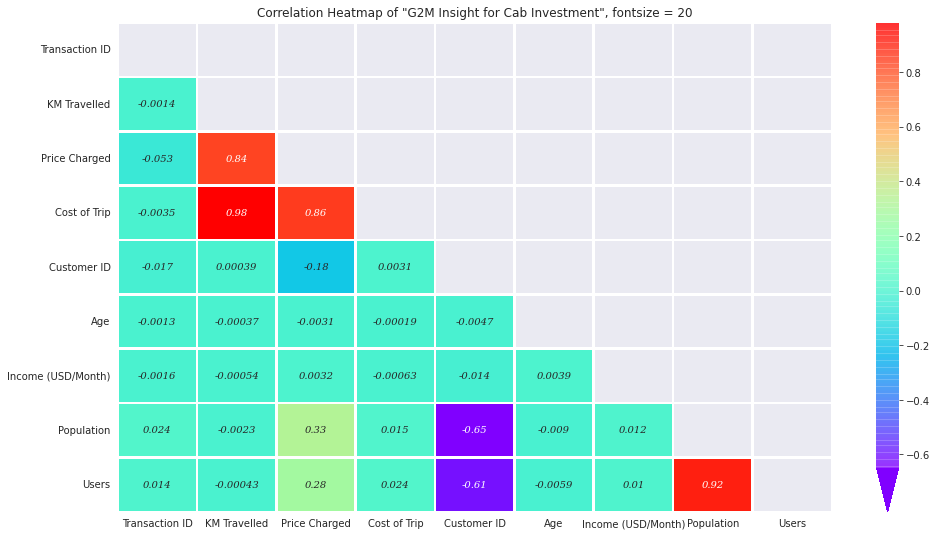

In [ ]:
# Define the figure size
plt.figure(figsize = (16, 9))

# Cutomize the annot
annot_kws={'fontsize':10,                      # To change the size of the font
           'fontstyle':'italic',               # To change the style of font 
           'fontfamily': 'serif',              # To change the family of font 
           'alpha':1 }                         # To change the transparency of the text  


# Customize the cbar
cbar_kws = {"shrink":1,                        # To change the size of the color bar
            'extend':'min',                    # To change the end of the color bar like pointed
            'extendfrac':0.1,                  # To adjust the extension of the color bar
            "drawedges":True,                  # To draw lines (edges) on the color bar
           }

# take upper correlation matrix
matrix = np.triu(data_corr)

# Generate heatmap correlation
ax = sns.heatmap(data_corr, mask = matrix, cmap = 'rainbow', annot = True, linewidth = 1.5 ,annot_kws= annot_kws, cbar_kws=cbar_kws)

# Set the title etc
plt.title('Correlation Heatmap of "G2M Insight for Cab Investment", fontsize = 20')

# Set the size of text
sns.set(font_scale = 1.2)

# ***From the heatmap correlation a strong -Correlation between***

<b>**-Population vs Users**</b>

 <b>-Price Charged vs Cost of Trip vs KM Travelled</b>

**User's Travel in both Pink & Yellow Cab**








In [ ]:
user=df.groupby('Company')
avg_user = user.Users.mean()
index = avg_user.index
value = avg_user.values 

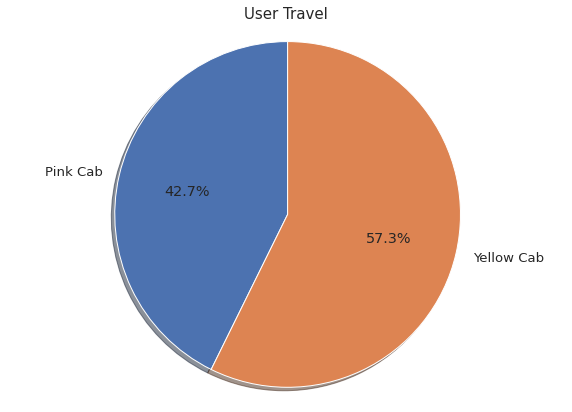

In [ ]:
figp, axp = plt.subplots(figsize=(10,7))
axp.pie(value , labels=index, autopct='%1.1f%%',shadow=True, startangle=90,)
axp.axis('equal')

plt.title('User Travel', fontsize = 15)
plt.show()

<b> Users Prefer `Yellow` Cab than `Pink` Cab</b>




**Comparison Of Price**

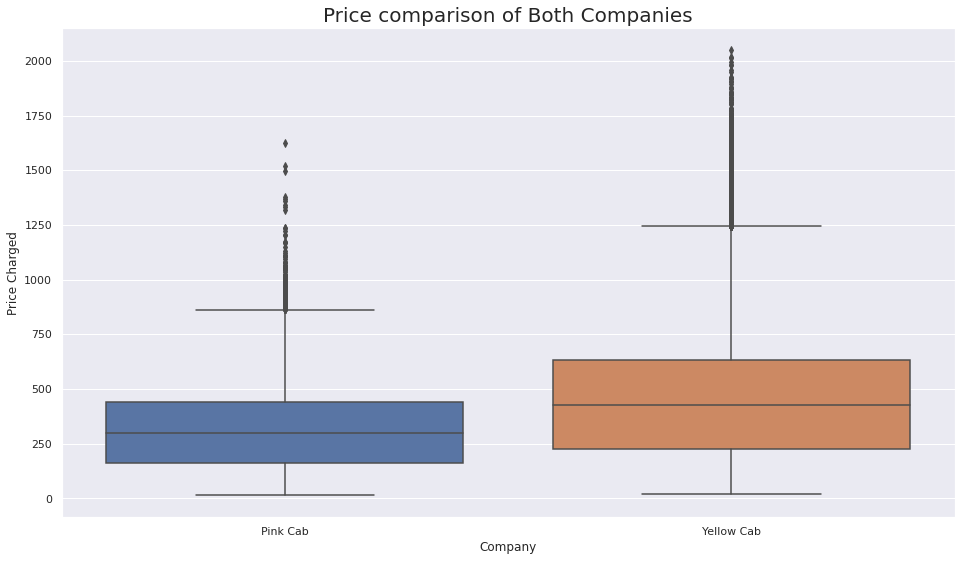

In [ ]:
sns.set(style = 'darkgrid')

plt.figure(figsize = (16, 9))

sns.boxplot(df['Company'], df['Price Charged'])
plt.title('Price comparison of Both Companies', fontsize=20)
plt.show()

<b> So the `Yellow Cab` is higher as compared to `Pink Cab` </b>

<br>**Demand of the 2 cab service providers** </br>

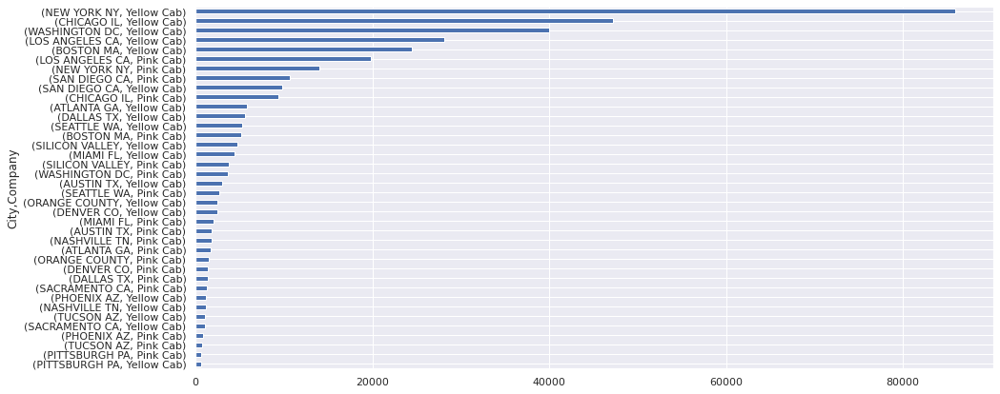

In [ ]:
plt.figure(figsize=(15, 7))
df.groupby('City').Company.value_counts().sort_values(ascending=True).plot(kind='barh');

# <br> **Travelled Distribution (KM)**</br>

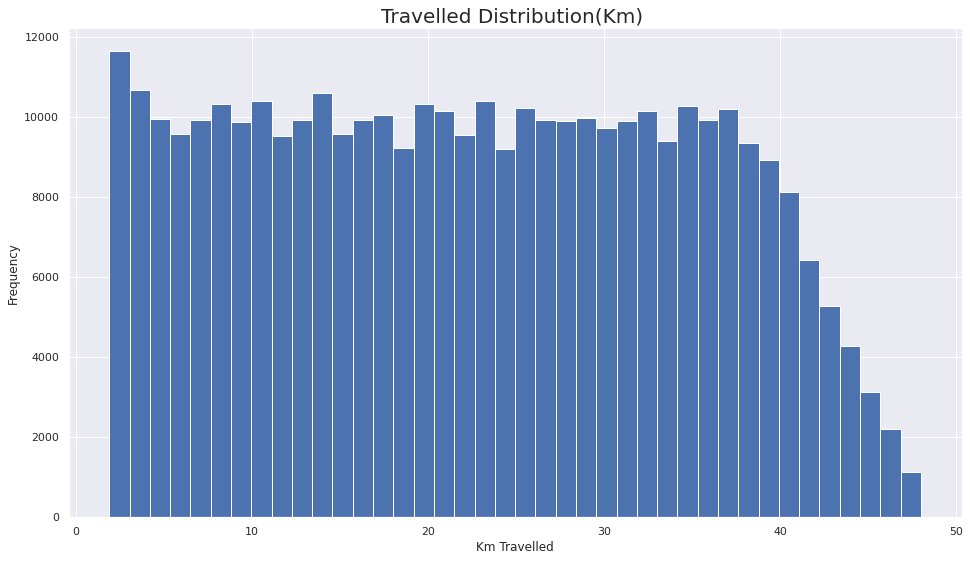

In [ ]:
plt.figure(figsize = (16, 9))
plt.hist(df['KM Travelled'], bins = 40)
plt.title('Travelled Distribution(Km) ', fontsize=20)
plt.ylabel('Frequency')
plt.xlabel('Km Travelled')
plt.show()

 <b> Most of the travelled rides varies from `2 - 48` KM. </b>

#**Gender**

In [ ]:
gender_cab=df.groupby(['Company','Gender'])
gender_cab  = gender_cab['Customer ID'].nunique()
print(gender_cab)

Company     Gender
Pink Cab    Female    14819
            Male      17511
Yellow Cab  Female    18394
            Male      21502
Name: Customer ID, dtype: int64


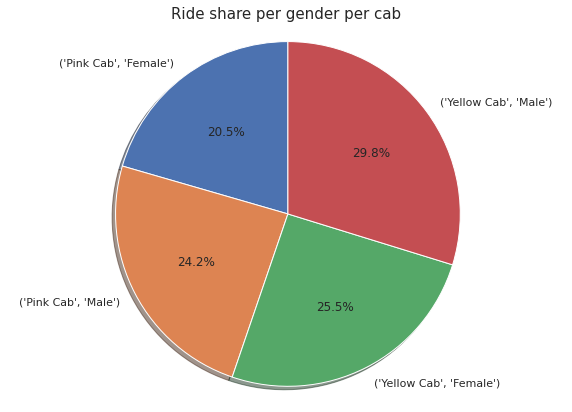

In [ ]:
labs = gender_cab.index
vals = gender_cab.values
figp, axp = plt.subplots(figsize=(10,7))
axp.pie(vals , labels=labs, autopct='%1.1f%%',shadow=True, startangle=90,)
axp.axis('equal')

plt.title('Ride share per gender per cab', fontsize = 15)
plt.show()

#▶*`Male` users are prefer more to travel in Cab* 
#▶*Users prefer to travel in `Yellow Cab`* 

#**No. of Male & female user**

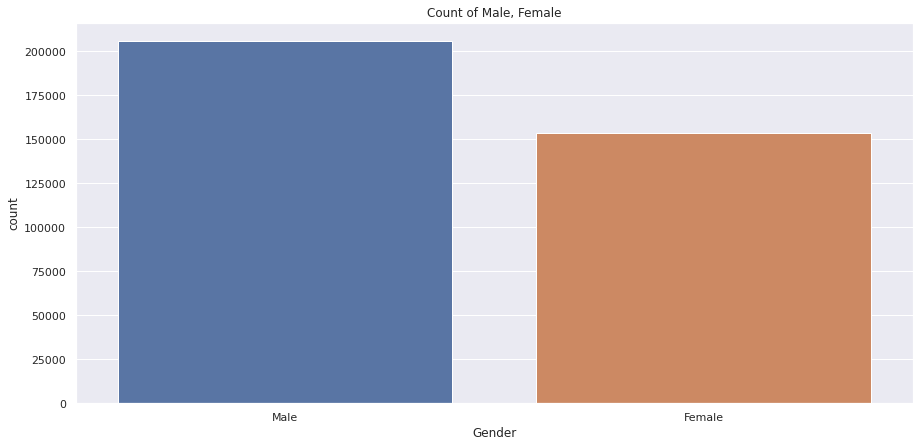

In [ ]:
plt.figure(figsize=(15,7))
g=sns.countplot(x = 'Gender', data = df);
g.set_title('Count of Male, Female')
plt.show()

#*▶ No. of male users are more than female users*

# **Payment Mode**

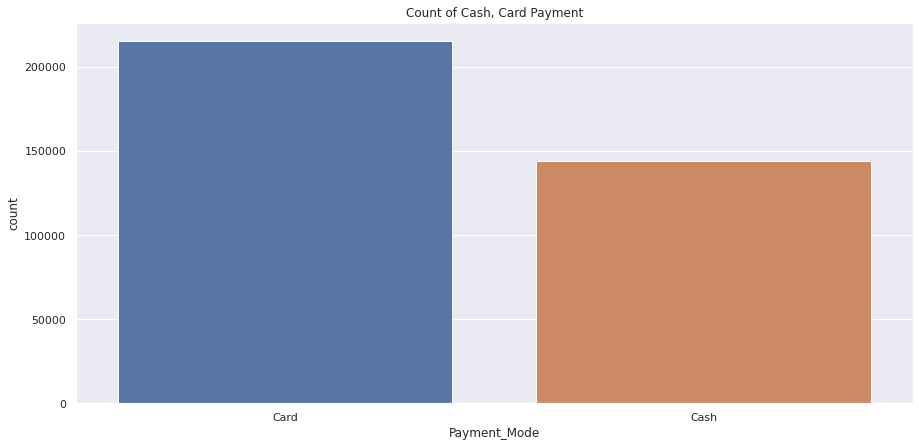

In [ ]:
plt.figure(figsize=(15,7))
g=sns.countplot(df['Payment_Mode']);
g.set_title('Count of Cash, Card Payment')
plt.show()

In [ ]:
df['Payment_Mode'].value_counts()

Card    215504
Cash    143888
Name: Payment_Mode, dtype: int64

#*▶ No. of Card payment is more than no. of cash payment*

#**Users per City** 

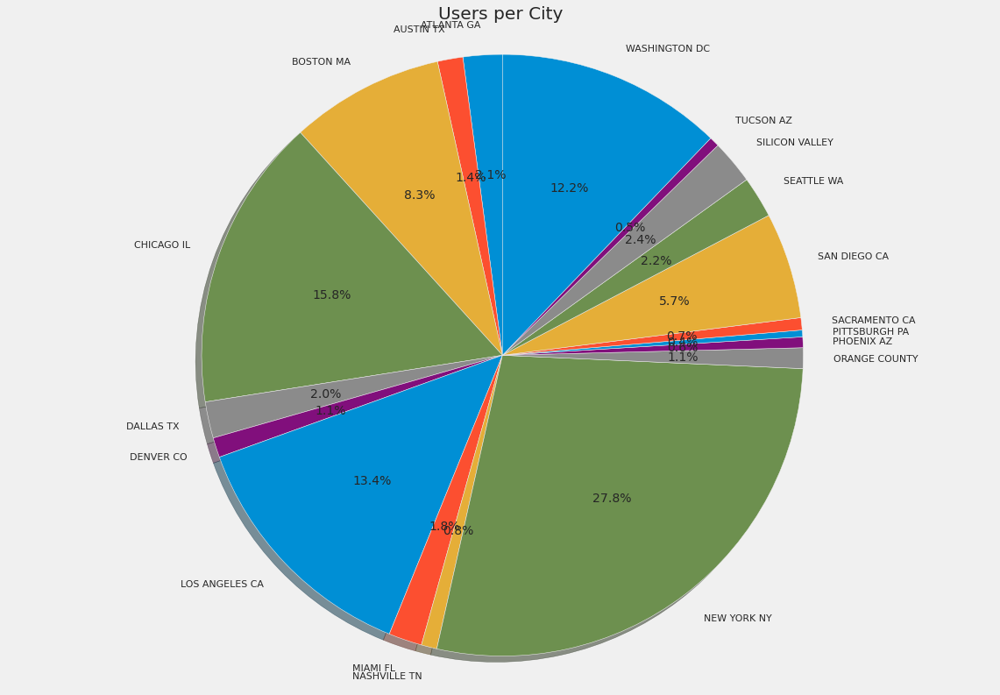

In [ ]:
city_users = df.groupby('City')
city_users = city_users.Users.count()
labs = city_users.index
vals = city_users.values

plt.style.use('fivethirtyeight')
figp, axp = plt.subplots(figsize=(18,13))
axp.pie(vals , labels=labs, autopct='%1.1f%%',shadow=True, startangle=90,)
axp.axis('equal')
plt.title('Users per City')
plt.show()

*▶`New York City`- `28%`* 
*▶Chicago`- `16%`*
*▶Los Angeles`- `13%*

#**Profit & Cost Analysis**

In [ ]:
company = df.groupby('Company')
price_charged = company['Price Charged'].mean()
cost_trip = company['Cost of Trip'].mean()
c = cost_trip.index
c_v = cost_trip.values
c_p = price_charged.values

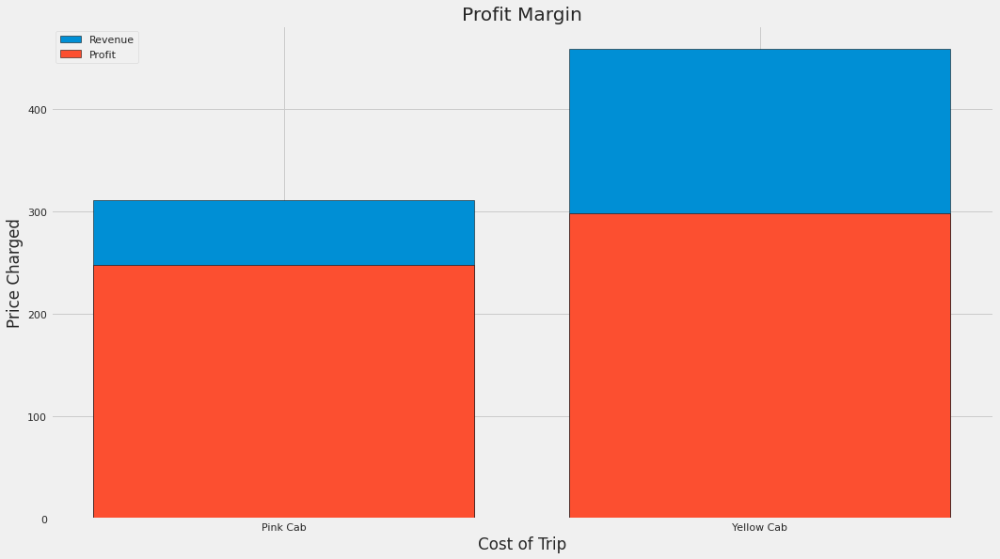

In [ ]:
plt.style.use('fivethirtyeight')
plt.figure(figsize = (16, 9))
plt.bar(c, c_p, edgecolor='black', label="Revenue")
plt.bar(c, c_v, edgecolor='black', label="Profit")
plt.title('Profit Margin')
plt.ylabel('Price Charged')
plt.xlabel('Cost of Trip')
plt.legend()
plt.show()

#*▶ The `Yellow cab` has a higher Profit Margin compared to `Pink cab`*

#**Profit Per Year**

In [ ]:
df['Year'] = df['Date of Travel'].dt.year
df['Month'] = df['Date of Travel'].dt.month
df['Day'] = df['Date of Travel'].dt.day
df['Profit'] = df['Price Charged'] - df['Cost of Trip']

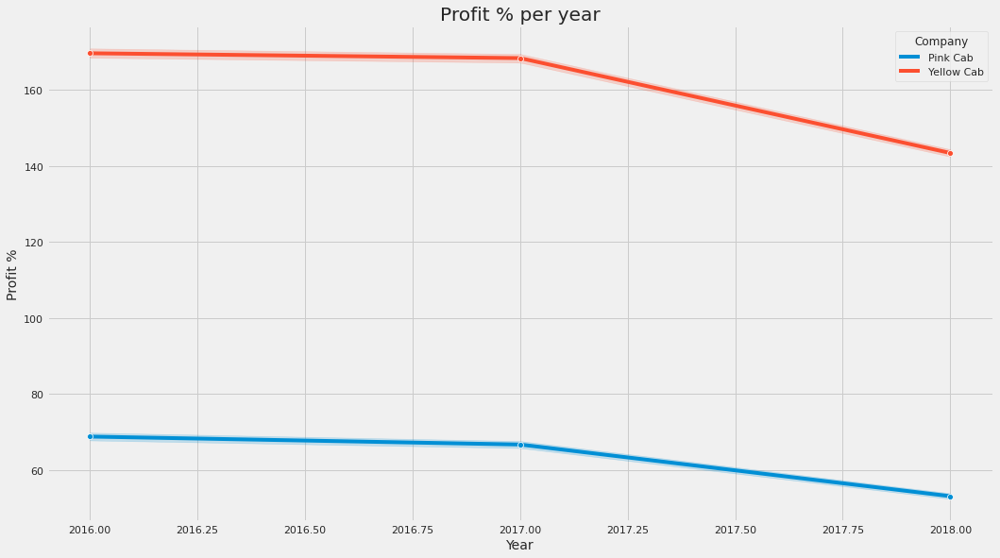

In [ ]:
plt.figure(figsize = (16, 9))
sns.lineplot(x='Year', y='Profit', hue="Company", data=df, marker='o')
plt.xlabel("Year", size=14)
plt.ylabel("Profit %", size=14)
plt.title("Profit % per year")
plt.show()

#*▶ The profit margin has `decreased` with respect to year*

#**Profit Per Month**

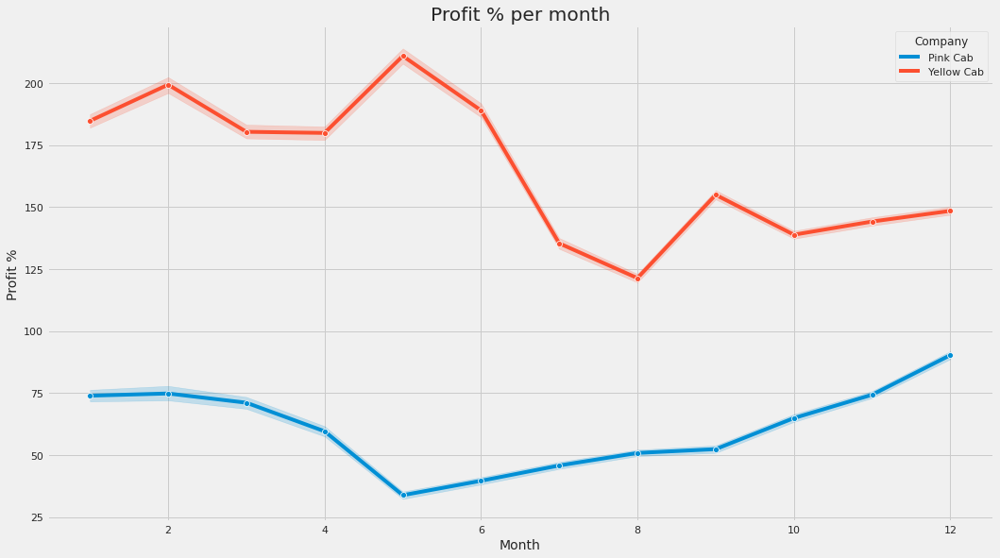

In [ ]:
plt.figure(figsize = (16, 9))
sns.lineplot(x='Month', y='Profit', hue="Company", data=df, marker='o')
plt.xlabel("Month", size=14)
plt.ylabel("Profit %", size=14)
plt.title("Profit % per month")
plt.show()

#*▶ The profit margin varies with respect to month*

#**Average Income**

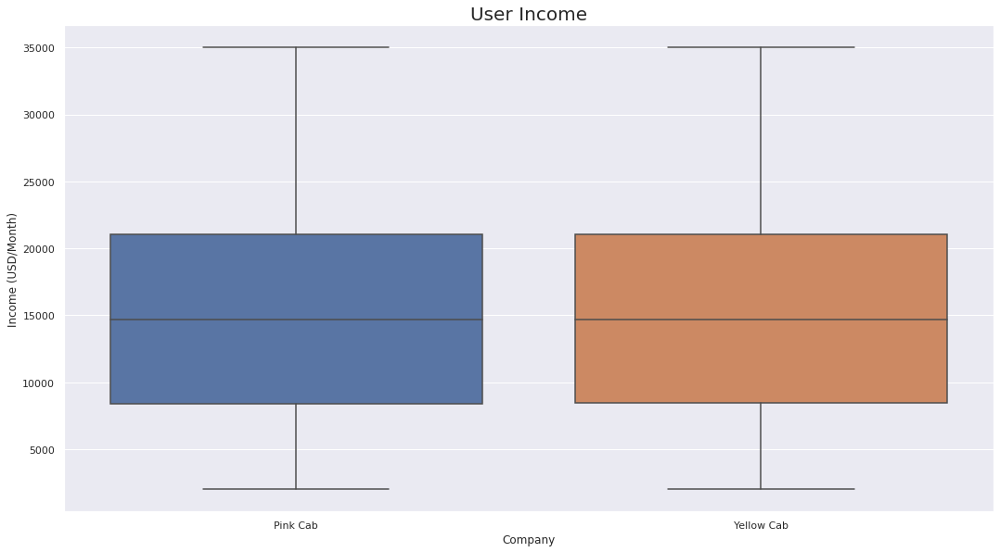

In [ ]:
sns.set(style = 'darkgrid')
plt.figure(figsize = (16, 9))
sns.boxplot(df['Company'], df['Income (USD/Month)'])
plt.title('User Income', fontsize=20)
plt.show()

 # *▶ Average income is around `USD15k` who use cab sevice*

#**Hypothesis**

In [ ]:
df.describe()

,Transaction ID,KM Travelled,Price Charged,Cost of Trip,Customer ID,Age,Income (USD/Month),Population,Users,Year,Month,Day,Profit
count,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,359392.000000
mean,1.022076e+07,22.567254,423.443311,286.190113,19191.652115,35.336705,15048.822937,3.132198e+06,158365.582267,2017.041693,7.509243,15.641700,137.253198
std,1.268058e+05,12.233526,274.378911,157.993661,21012.412463,12.594234,7969.409482,3.315194e+06,100850.051020,0.801378,3.428929,8.838986,160.311840
min,1.000001e+07,1.900000,15.600000,19.000000,1.000000,18.000000,2000.000000,2.489680e+05,3643.000000,2016.000000,1.000000,1.000000,-220.060000
25%,1.011081e+07,12.000000,206.437500,151.200000,2705.000000,25.000000,8424.000000,6.712380e+05,80021.000000,2016.000000,5.000000,8.000000,28.012000
50%,1.022104e+07,22.440000,386.360000,282.480000,7459.000000,33.000000,14685.000000,1.595037e+06,144132.000000,2017.000000,8.000000,16.000000,81.962000
75%,1.033094e+07,32.960000,583.660000,413.683200,36078.000000,42.000000,21035.000000,8.405837e+06,302149.000000,2018.000000,11.000000,23.000000,190.030000
max,1.044011e+07,48.000000,2048.030000,691.200000,60000.000000,65.000000,35000.000000,8.405837e+06,302149.000000,2018.000000,12.000000,31.000000,1463.966000


#Hypothesis-01 Charged Price Same or Not

***▶ H0 = Price charged by Pink & Yellow Cabs are same***

***▶ H1 = Price charged by Pink & Yellow Cabs are not same***

In [ ]:
sample_size = int((10/100)*359392) # Considering 10% values as sample data

def T_Test(a, b):
    sample_a = np.random.choice(a, sample_size)
    sample_b = np.random.choice(b, sample_size)
    ttest, p_value = ttest_ind(sample_a, sample_b, equal_var = False)
    print(f'p-value: {p_value}')
    if p_value < 0.05:    # alpha value is 0.05 or 5%
        print("Null hypothesis has rejected  (H1)")
    else:
        print("Null hypothesis has acceped (H0)")

In [ ]:
df['KM Travelled'].groupby(df['Company']).mean()

Company
Pink Cab      22.559917
Yellow Cab    22.569517
Name: KM Travelled, dtype: float64

In [ ]:
T_Test(df[df['Company'] == 'Yellow Cab']['KM Travelled'], df[df['Company'] == 'Pink Cab']['KM Travelled'])

p-value: 0.25975663154613765
Null hypothesis has acceped (H0)


#Hypothesis-02 Difference Between Age

***▶H0 = There is no difference between Age in both cab companies*** 

***▶H1 = There is difference between Age in both cab companies***

In [ ]:
a = df[(df.Age <= 60)&(df.Company=='Pink Cab')].groupby('Transaction ID').Profit.mean()
b = df[(df.Age >= 60)&(df.Company=='Pink Cab')].groupby('Transaction ID').Profit.mean()
print(a.shape[0],b.shape[0])

_, p_value = stats.ttest_ind(a.values,
                             b.values,
                             equal_var=True)

print('P value is ', p_value)

if(p_value<0.05):
    print('We accept alternative hypothesis (H1) that there is a difference between age for Pink Cab')
else:
    print('We accept null hypothesis (H0) that there is no difference between age for Pink Cab')

80125 5429
P value is  0.4816748536155635
We accept null hypothesis (H0) that there is no difference between age for Pink Cab


In [ ]:
a = df[(df.Age <= 60)&(df.Company=='Yellow Cab')].groupby('Transaction ID').Profit.mean()
b = df[(df.Age >= 60)&(df.Company=='Yellow Cab')].groupby('Transaction ID').Profit.mean()
print(a.shape[0],b.shape[0])

_, p_value = stats.ttest_ind(a.values,
                             b.values,
                             equal_var=True)

print('P value is ', p_value)

if(p_value<0.05):
    print('We accept alternative hypothesis (H1) that there is a difference between age for Yellow Cab')
else:
    print('We accept null hypothesis (H0) that there is no difference between age for Yellow Cab')

260356 17257
P value is  6.328485471267631e-05
We accept alternative hypothesis (H1) that there is a difference between age for Yellow Cab


#Hypothesis-03 Profit difference for both cab services

***▶H0 =  Profit is same for both cab services***

***▶H1 = Profit is not same for both cab services*** 

In [ ]:
df['Profit'].groupby(df['Company']).mean()

Company
Pink Cab       62.652174
Yellow Cab    160.259986
Name: Profit, dtype: float64

In [ ]:
T_Test(df[df['Company'] == 'Yellow Cab']['Profit'], df[df['Company'] == 'Pink Cab']['Profit'])

p-value: 0.0
Null hypothesis has rejected  (H1)


#Hypothesis-04 Travelled distance difference for both cab services

***▶H0 = Distance travelled by both Cabs are same***

***▶H1 = Distance travelled by both Cabs are not same*** 


In [ ]:
df['KM Travelled'].groupby(df['Company']).mean()

Company
Pink Cab      22.559917
Yellow Cab    22.569517
Name: KM Travelled, dtype: float64

In [ ]:
T_Test(df[df['Company'] == 'Yellow Cab']['KM Travelled'], df[df['Company'] == 'Pink Cab']['KM Travelled'])

p-value: 0.09478569532523495
Null hypothesis has acceped (H0)


#Hypothesis-04 Difference in Profit in Payment mode

***▶H0 = Has profit difference in Payment_Mode in both cab companies***

***▶H1 = Has no profit difference in Payment_Mode in both cab companies*** 

In [ ]:
a = df[(df['Payment_Mode']=='Cash')&(df.Company=='Pink Cab')].groupby('Transaction ID').Profit.mean()
b = df[(df['Payment_Mode']=='Card')&(df.Company=='Pink Cab')].groupby('Transaction ID').Profit.mean()

_, p_value = stats.ttest_ind(a.values,
                             b.values,
                             equal_var=True)

print('P value is ', p_value)

if(p_value<0.05):
    print('We accept alternative hypothesis (H1) that there is a difference in payment mode for Pink Cab')
else:
    print('We accept null hypothesis (H0) that there is no difference in payment mode for Pink Cab')

P value is  0.7900465828793288
We accept null hypothesis (H0) that there is no difference in payment mode for Pink Cab


In [ ]:
a = df[(df['Payment_Mode']=='Cash')&(df.Company=='Yellow Cab')].groupby('Transaction ID').Profit.mean()
b = df[(df['Payment_Mode']=='Card')&(df.Company=='Yellow Cab')].groupby('Transaction ID').Profit.mean()

_, p_value = stats.ttest_ind(a.values,
                             b.values,
                             equal_var=True)

print('P value is ', p_value)

if(p_value<0.05):
    print('We accept alternative hypothesis (H1) that there is a difference in payment mode for Yellow Cab')
else:
    print('We accept null hypothesis (H0) that there is no difference in payment mode for Yellow Cab')

P value is  0.2933060638298729
We accept null hypothesis (H0) that there is no difference in payment mode for Yellow Cab
